In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import torchaudio
import torch
import numpy as np
import os
import IPython.display as ipd

In [3]:
def hann_window(N):
    n = np.arange(N)
    return 0.5 * (1 - np.cos(2 * np.pi * n / (N - 1)))

def hamm_window(N):
    n = np.arange(N)
    return 0.54 - 0.46 * np.cos(2 * np.pi * n / (N - 1))

def rectangular_window(N):
    return np.ones(N)

In [4]:
def compute_stft(file_path, n_fft=1024, win_length=1024, device='cpu', window_type = None):
    hop_length = win_length // 2
    waveform, sample_rate = torchaudio.load(file_path)

    if waveform.shape[0] > 1:
        waveform = torch.mean(waveform, dim=0, keepdim=True)

    waveform = waveform.to(device)
    window = torch.tensor(window_type(win_length), dtype=torch.float32, device=device)
    num_frames = (waveform.shape[1] - win_length) // hop_length + 1
    spectrogram = torch.zeros(n_fft // 2 + 1, num_frames, device=device)
    for i in range(num_frames):
        start = i * hop_length
        end = start + win_length
        frame = waveform[:, start:end]

        if frame.shape[1] < win_length:
            continue
        windowed_frame = frame * window
        spectrum = torch.fft.rfft(windowed_frame, n=n_fft)
        spectrogram[:, i] = spectrum.abs().squeeze()

    return spectrogram, sample_rate

def plot_spectrogram(spectrogram, sample_rate, n_fft=1024, hop_length=None, win_length=None, window = None):
    hop_length = hop_length or n_fft // 2
    win_length = win_length or n_fft
    spectrogram_db = 20 * torch.log10(spectrogram + 1e-6)
    spectrogram_db = spectrogram_db.cpu().numpy()
    num_frames = spectrogram_db.shape[1]
    time_axis = np.arange(num_frames) * hop_length / sample_rate  # Time in seconds
    freq_axis = np.arange(spectrogram_db.shape[0]) * sample_rate / n_fft  # Frequency in Hz
    plt.figure(figsize=(10, 6))

    plt.imshow(spectrogram_db, cmap='plasma', aspect='auto', origin='lower', interpolation='none',
           extent=[time_axis[0], time_axis[-1], freq_axis[0], freq_axis[-1]])
    plt.colorbar(format="%+2.0f dB")

    plt.title(f'{window} Spectrogram (dB)', color='Black')
    plt.xlabel('Time (s)', color='Black')
    plt.ylabel('Frequency (Hz)', color='Black')
    plt.show()

In [5]:
audio_folder_path = r'/content/drive/MyDrive/SEM_4/SPEECH/UrbanSound8K/audio'
meta_data = pd.read_csv('/content/drive/MyDrive/SEM_4/SPEECH/UrbanSound8K/metadata/UrbanSound8K.csv')
fold1_data = meta_data[meta_data['fold'] == 1]
filtered_data = fold1_data.groupby('class').first().reset_index()
filtered_data

,class,slice_file_name,fsID,start,end,salience,fold,classID
0,air_conditioner,127873-0-0-0.wav,127873,0.000000,2.040750,1,1,0
1,car_horn,156194-1-0-0.wav,156194,0.000000,0.252086,2,1,1
2,children_playing,105415-2-0-1.wav,105415,0.500000,4.500000,1,1,2
3,dog_bark,101415-3-0-2.wav,101415,1.000000,5.000000,1,1,3
4,drilling,14113-4-0-0.wav,14113,0.000000,4.000000,1,1,4
5,engine_idling,103258-5-0-0.wav,103258,0.000000,4.000000,1,1,5
6,gun_shot,102305-6-0-0.wav,102305,0.000000,2.611610,1,1,6
7,jackhammer,103074-7-0-0.wav,103074,3.341279,7.341279,1,1,7
8,siren,106905-8-0-0.wav,106905,43.636489,47.636489,2,1,8
9,street_music,108041-9-0-11.wav,108041,5.500000,9.500000,1,1,9


class : 0 air_conditioner


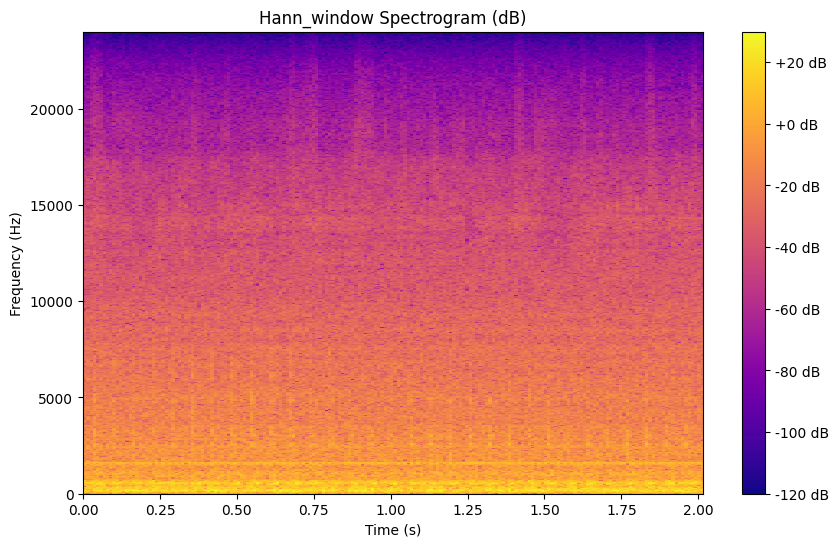

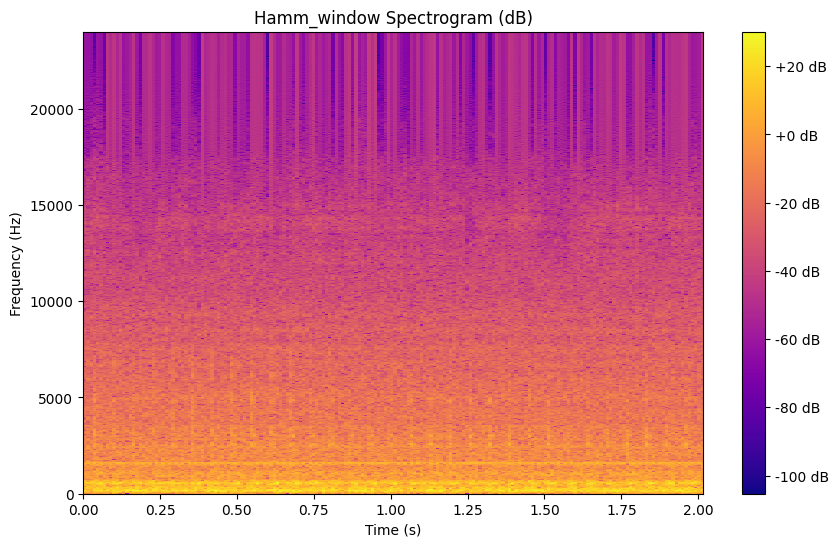

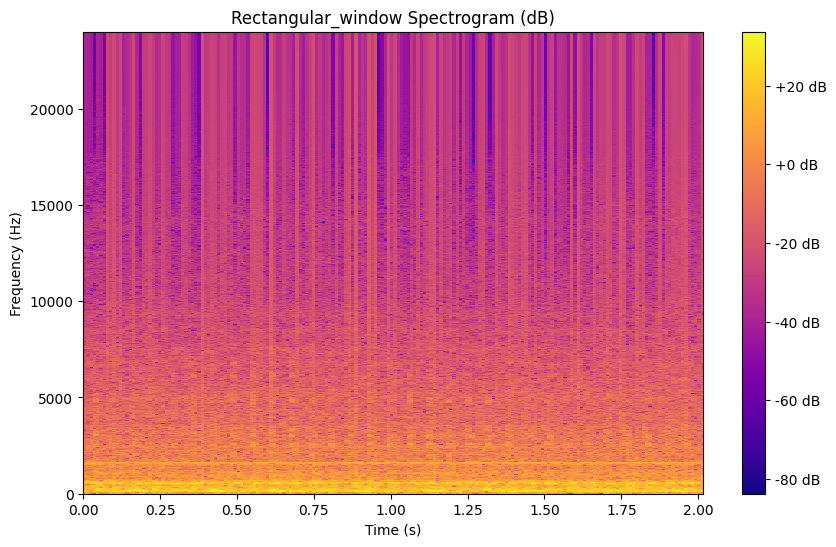

class : 1 car_horn


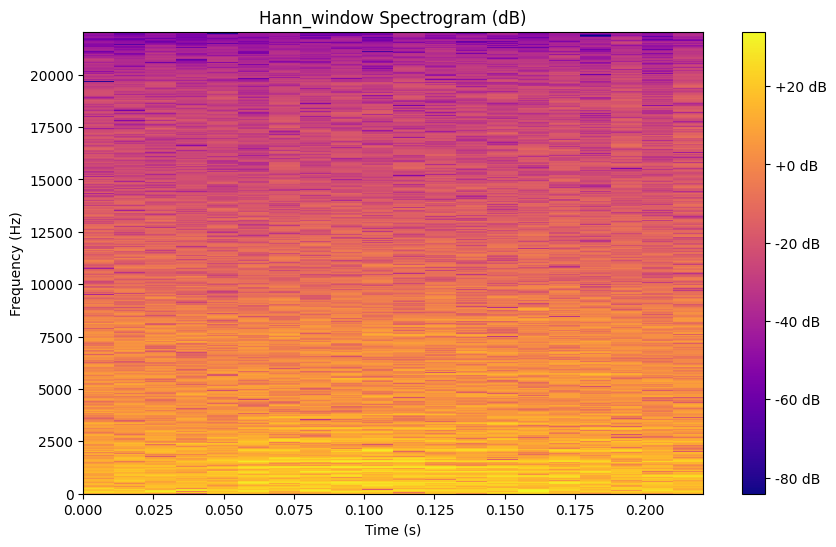

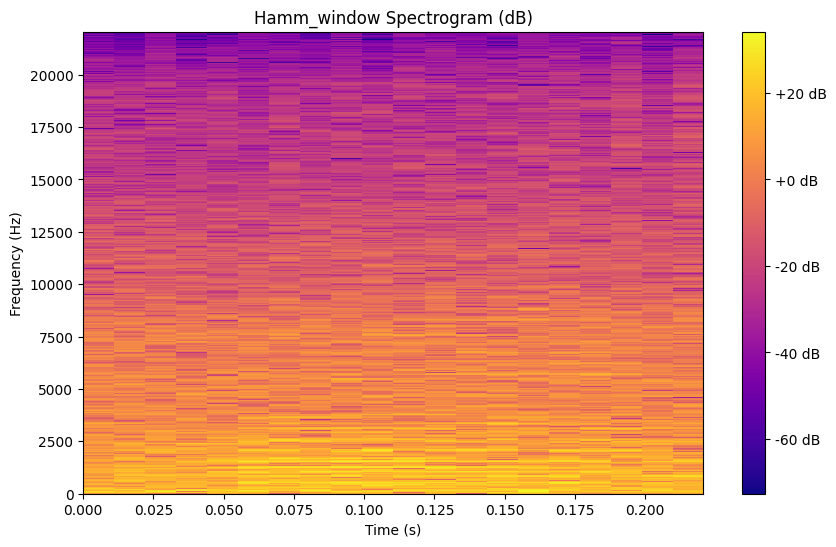

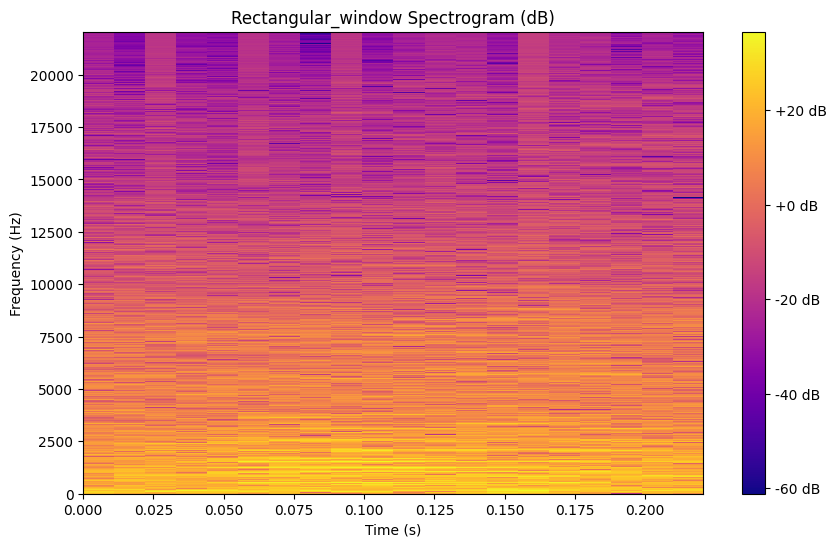

class : 2 children_playing


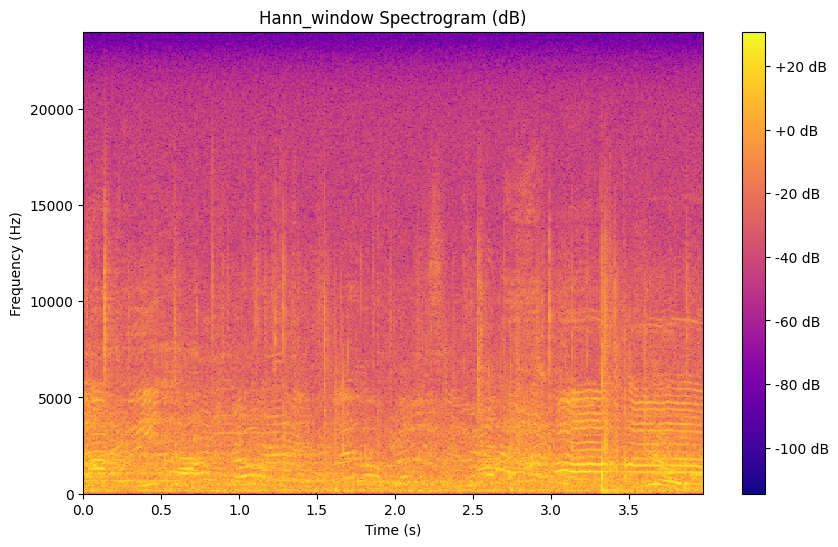

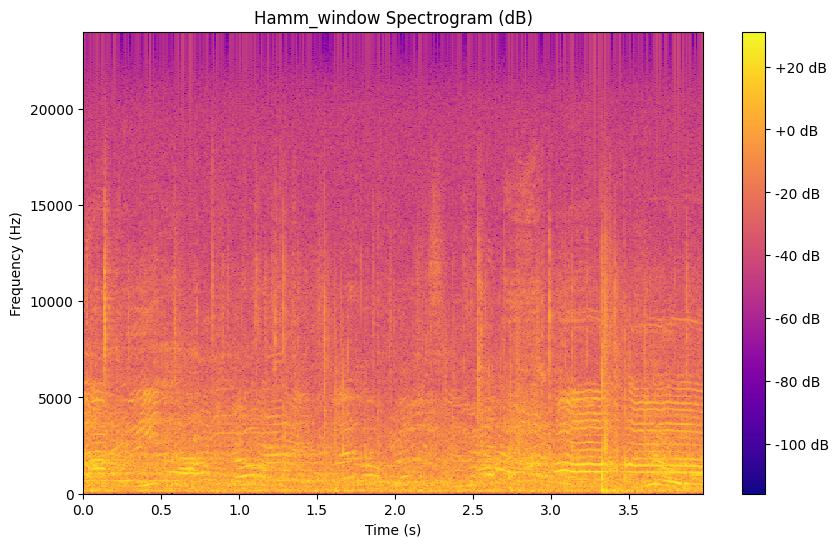

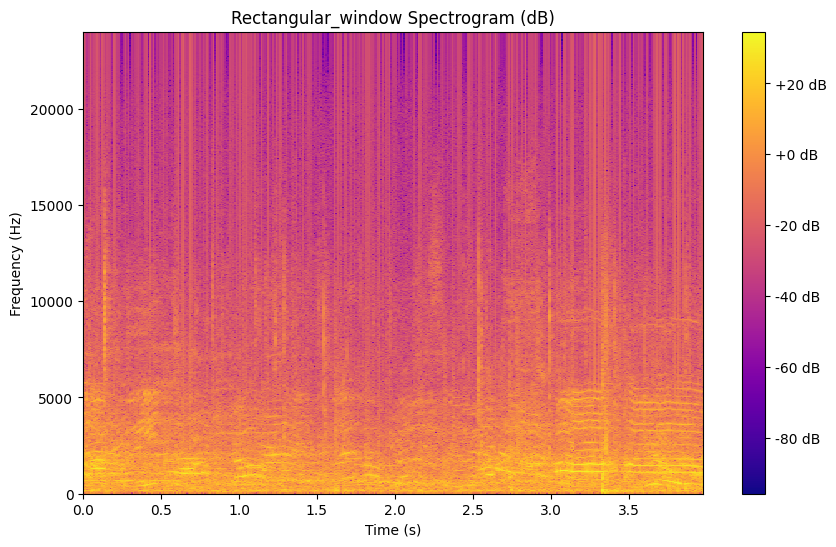

class : 3 dog_bark


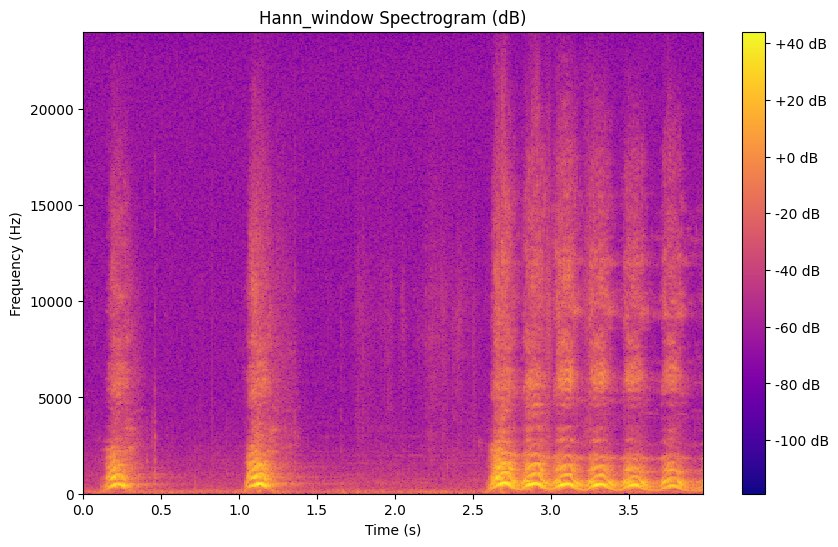

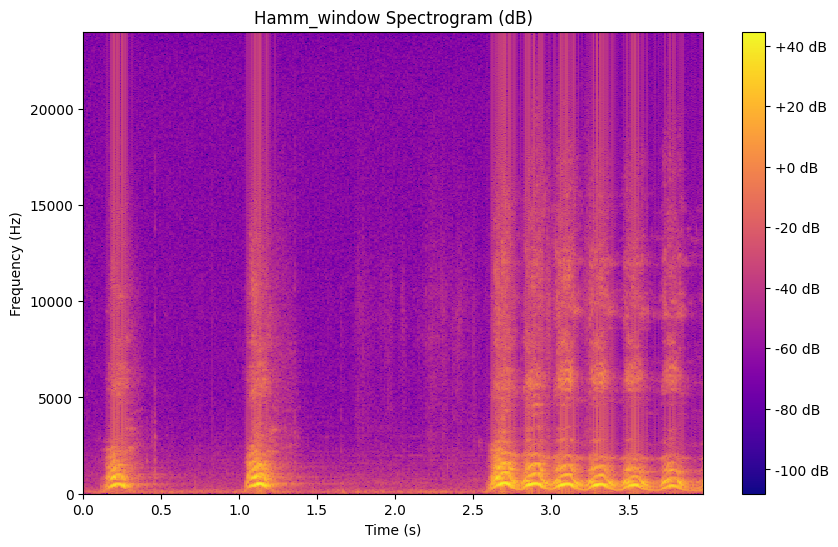

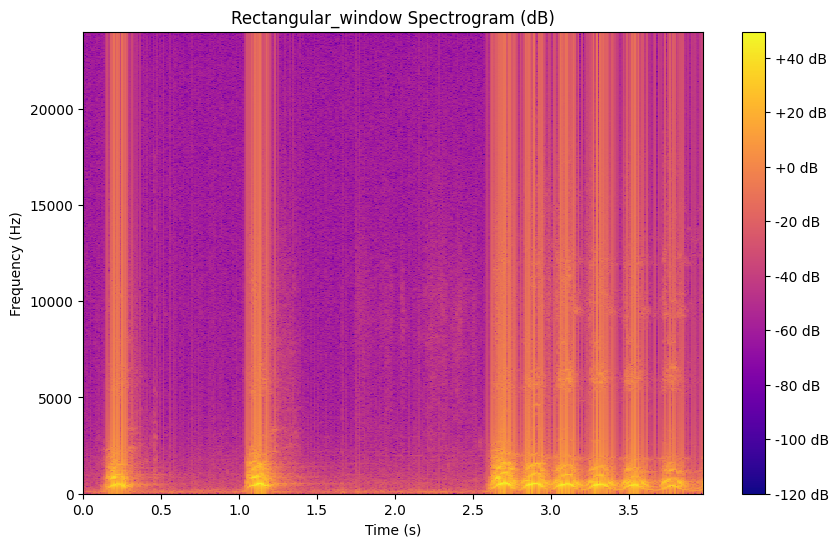

class : 4 drilling


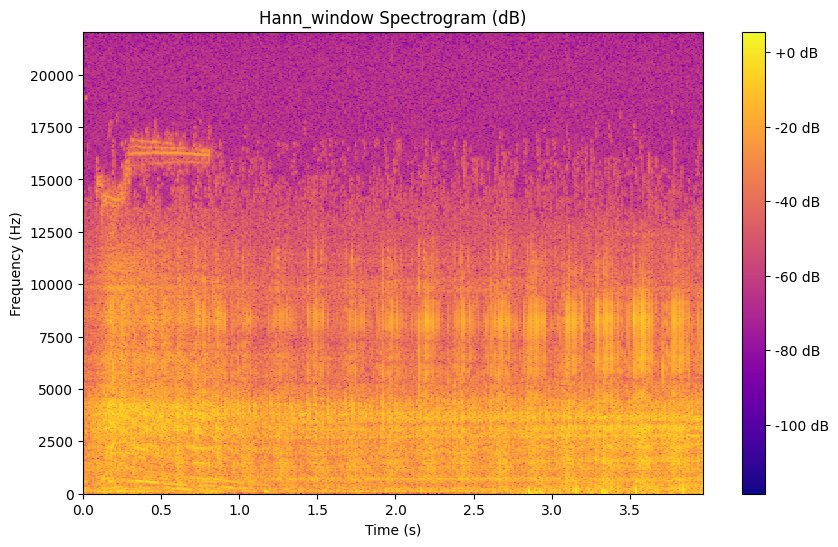

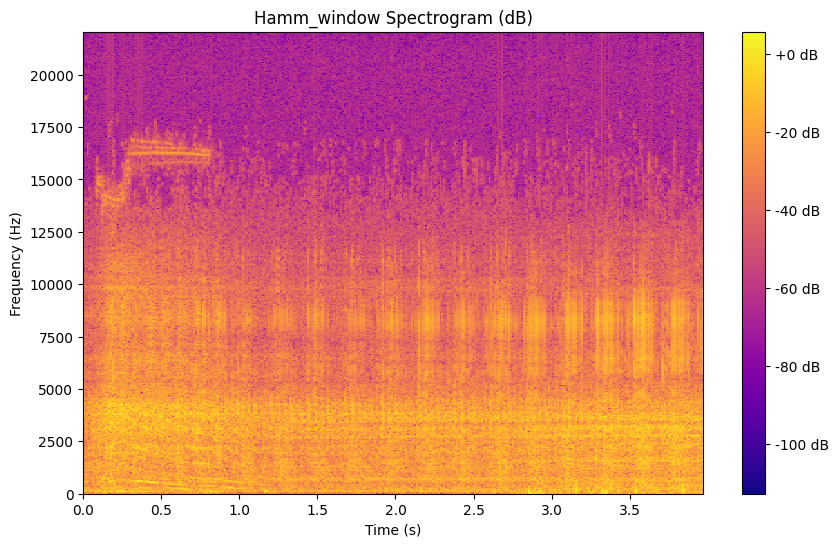

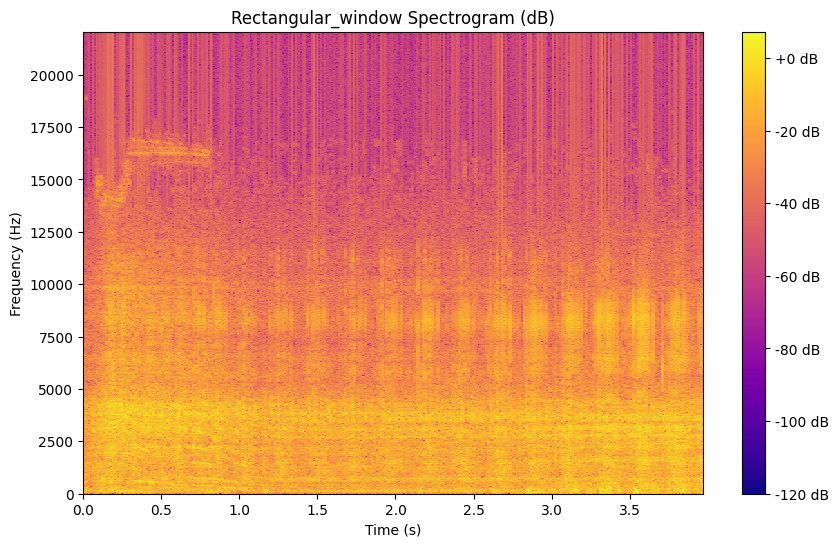

class : 5 engine_idling


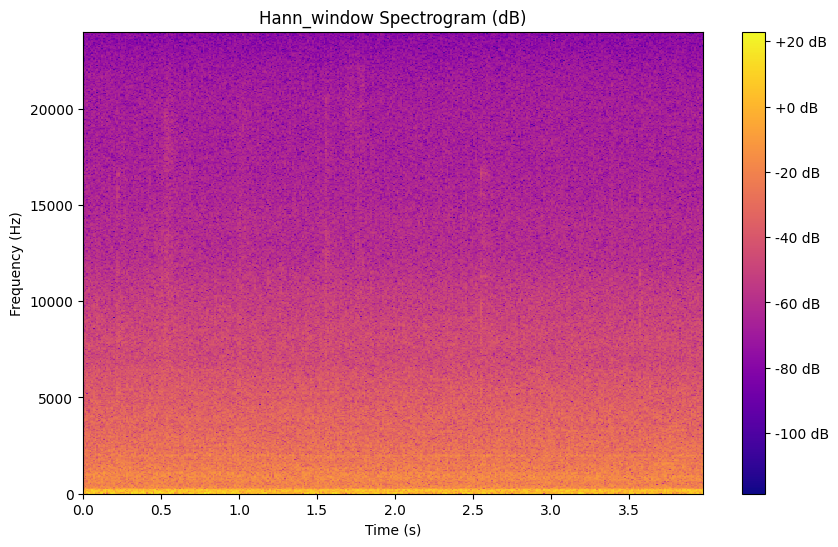

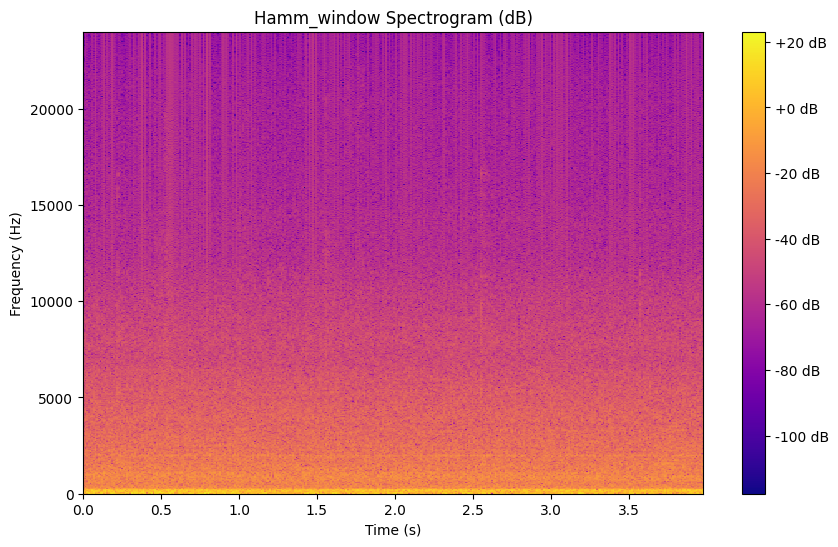

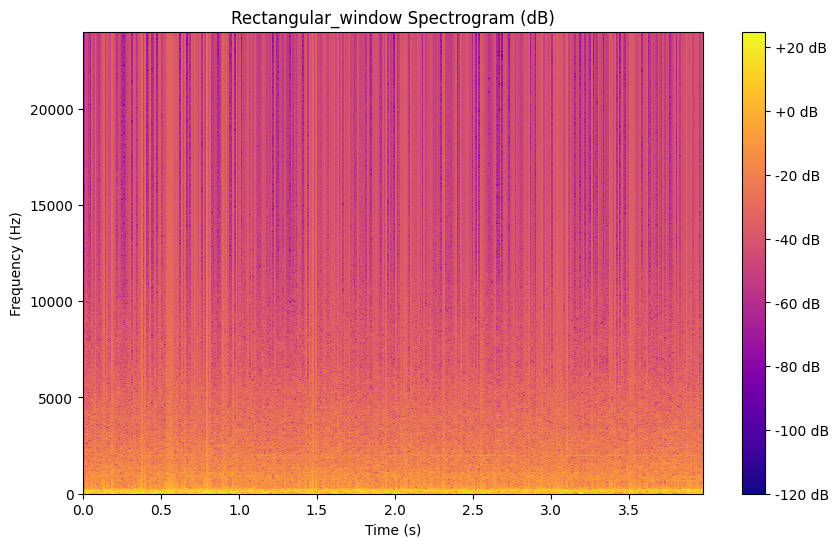

class : 6 gun_shot


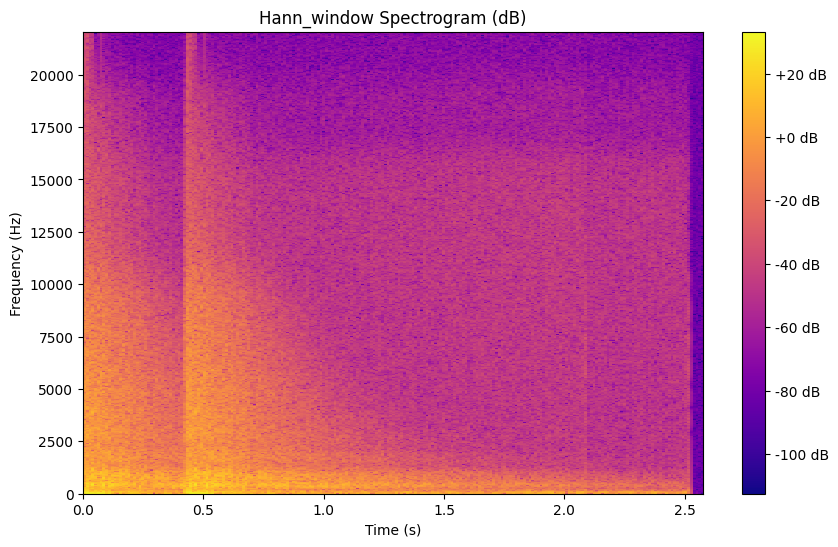

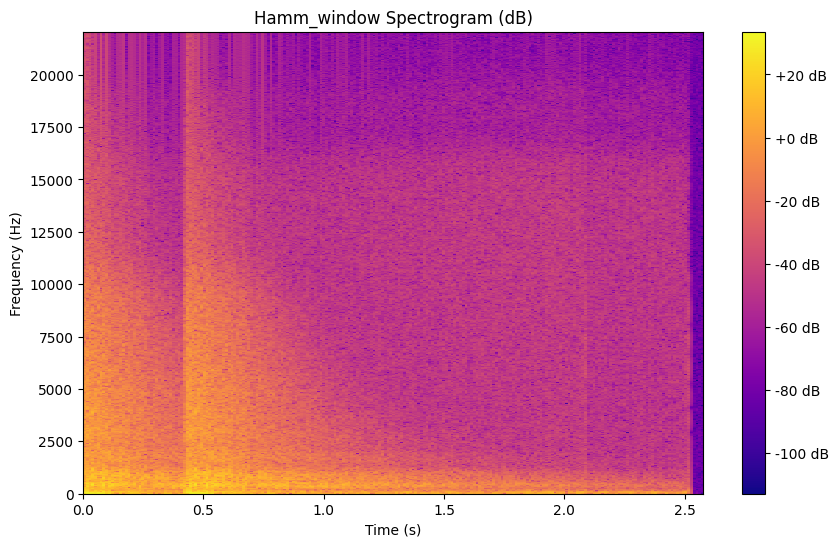

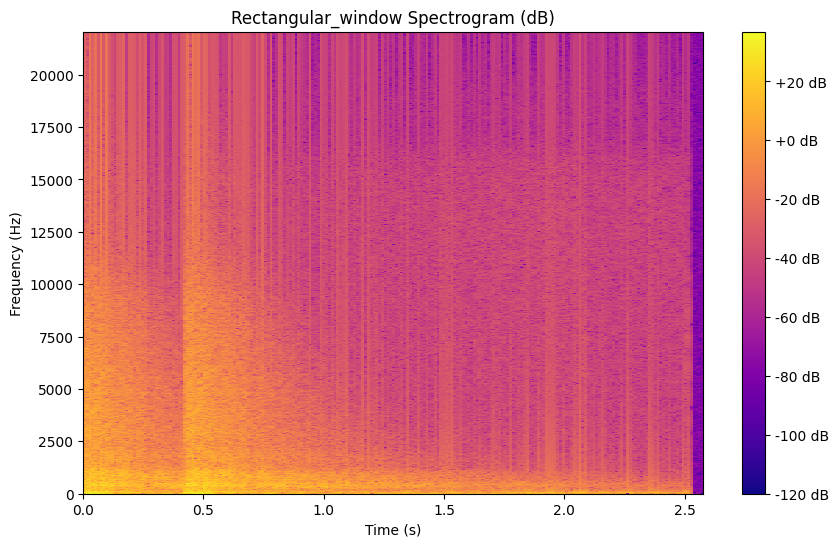

class : 7 jackhammer


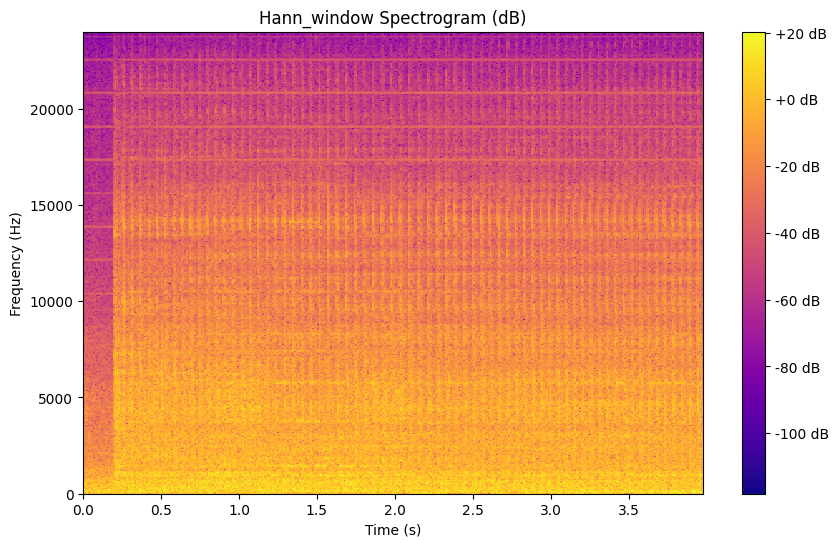

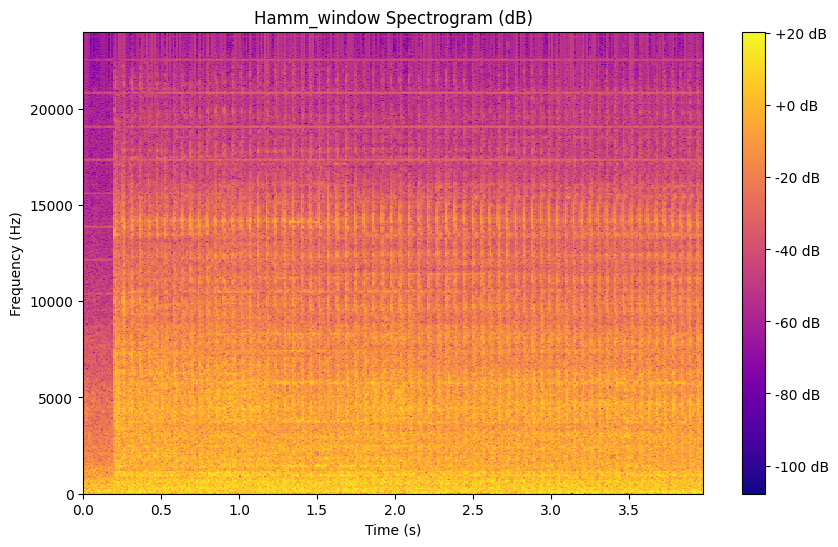

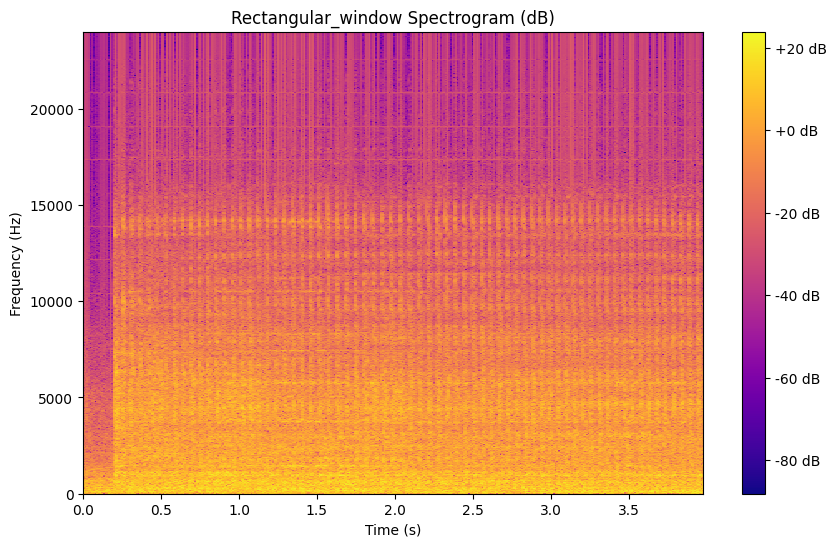

class : 8 siren


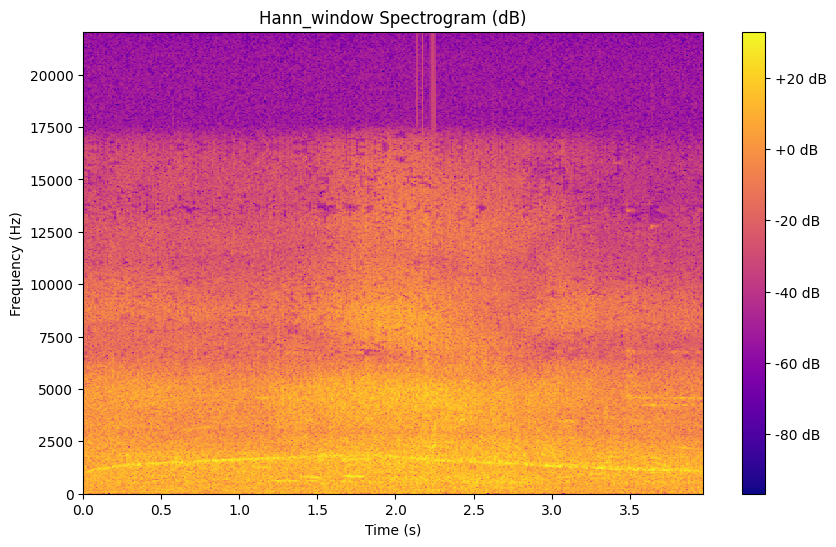

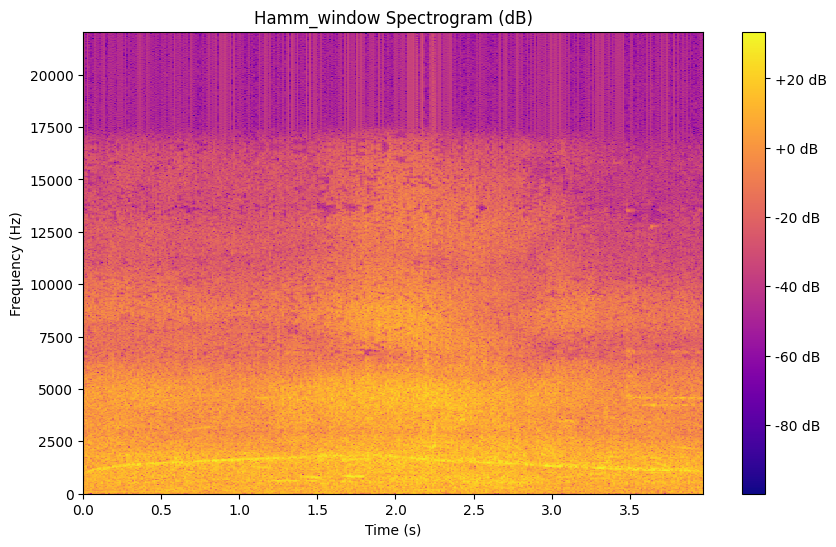

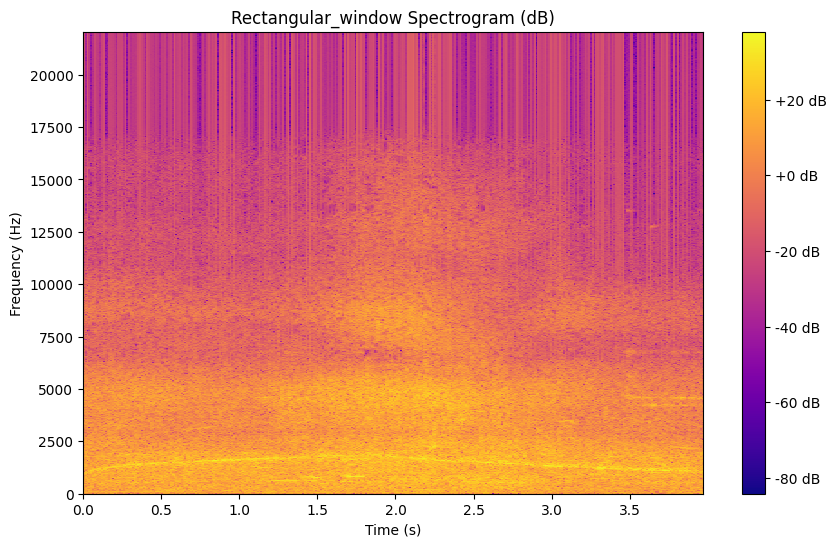

class : 9 street_music


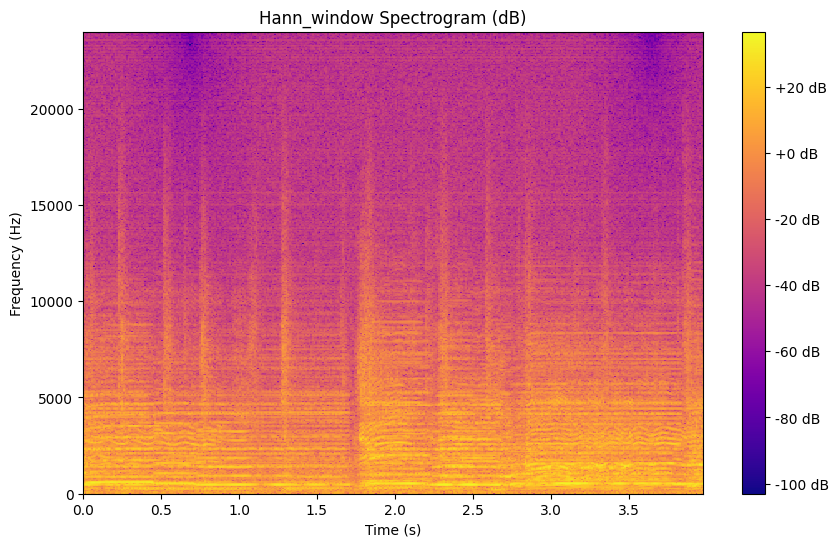

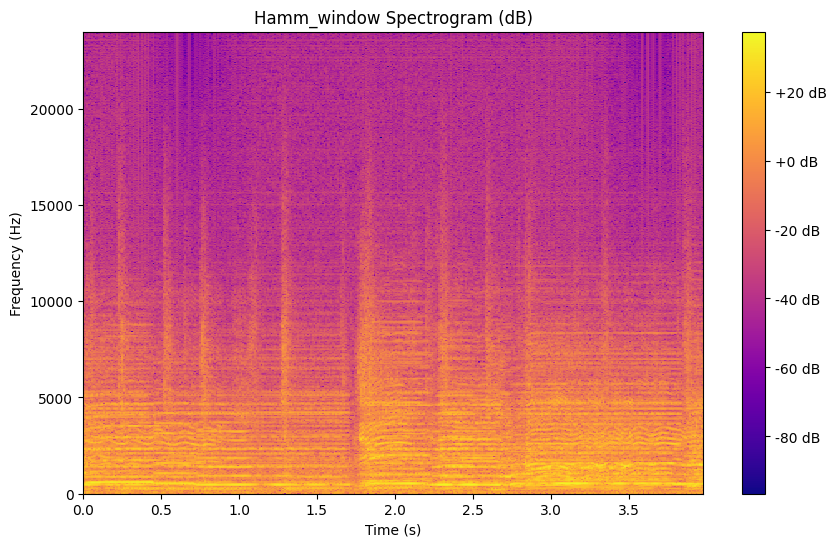

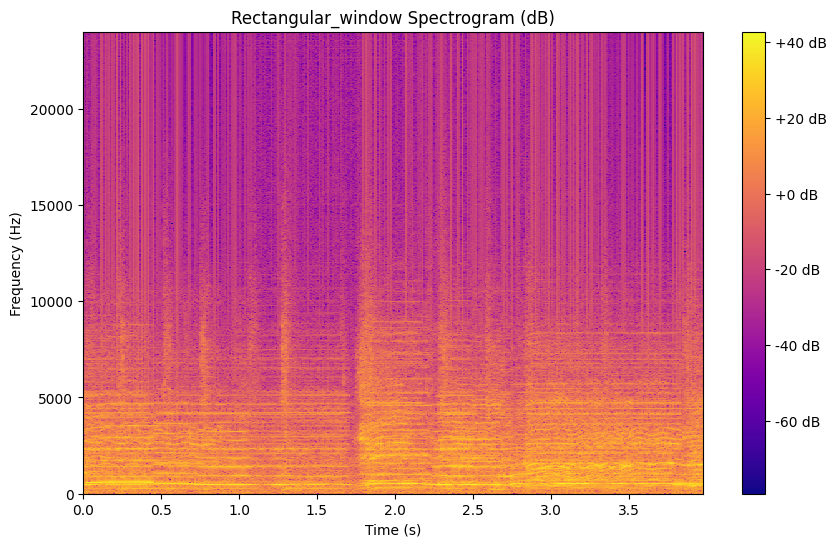

In [6]:
fold1_path = r'/content/drive/MyDrive/SEM_4/SPEECH/UrbanSound8K/audio/fold1'
for i in range(len(filtered_data)):
    print('class :', i, filtered_data.iloc[i]['class'])
    audio_path = os.path.join(fold1_path, filtered_data.iloc[i]['slice_file_name'])
    display(ipd.Audio(audio_path))
    spectogram, sr = compute_stft(audio_path, window_type = hann_window )
    plot_spectrogram(spectogram, sr, window = 'Hann_window')

    spectogram, sr = compute_stft(audio_path, window_type = hamm_window )
    plot_spectrogram(spectogram, sr, window = 'Hamm_window')

    spectogram, sr = compute_stft(audio_path, window_type = rectangular_window)
    plot_spectrogram(spectogram, sr, window = 'Rectangular_window')